## Data explanation

- 

In [1]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.express as px

# Read In csvs
games = pd.read_csv("../data/games.csv")
plays = pd.read_csv("../data/plays.csv")
players = pd.read_csv("../data/players.csv")
week1 = pd.read_csv("../data/week1.csv")

week_all = []
for i in range(1, 8 + 1):
    week_all.append(pd.read_csv('../data/week{}.csv'.format(i)))
week_all = pd.concat(week_all)

pffScoutingData = pd.read_csv("../data/pffScoutingData.csv")
joined_all = pd.merge(games,plays,how="inner",on = "gameId")
joined_all = pd.merge(joined_all,week1,how="inner",on=["gameId","playId"])
# left join on players to keep football records
joined_all = pd.merge(joined_all,players,how="left",on = "nflId")
play_focus = 97
focused_df = joined_all[(joined_all.playId==play_focus)]

colors = {
    'ARI':"#97233F", 
    'ATL':"#A71930", 
    'BAL':'#241773', 
    'BUF':"#00338D", 
    'CAR':"#0085CA", 
    'CHI':"#C83803", 
    'CIN':"#FB4F14", 
    'CLE':"#311D00", 
    'DAL':'#003594',
    'DEN':"#FB4F14", 
    'DET':"#0076B6", 
    'GB':"#203731", 
    'HOU':"#03202F", 
    'IND':"#002C5F", 
    'JAX':"#9F792C", 
    'KC':"#E31837", 
    'LA':"#003594", 
    'LAC':"#0080C6", 
    'LV':"#000000",
    'MIA':"#008E97", 
    'MIN':"#4F2683", 
    'NE':"#002244", 
    'NO':"#D3BC8D", 
    'NYG':"#0B2265", 
    'NYJ':"#125740", 
    'PHI':"#004C54", 
    'PIT':"#FFB612", 
    'SEA':"#69BE28", 
    'SF':"#AA0000",
    'TB':'#D50A0A', 
    'TEN':"#4B92DB", 
    'WAS':"#5A1414", 
    'football':'#CBB67C'
}


In [2]:

def animate_play_v2(tracking_df, play_df,players,pffScoutingData, gameId,playId):
    selected_play_df = play_df[(play_df.playId==playId)&(play_df.gameId==gameId)].copy()
    
    tracking_players_df = pd.merge(tracking_df,players,how="left",on = "nflId")
    tracking_players_df = pd.merge(tracking_players_df,pffScoutingData,how="left",on = ["nflId","playId","gameId"])
    selected_tracking_df = tracking_players_df[(tracking_players_df.playId==playId)&(tracking_players_df.gameId==gameId)].copy()

    sorted_frame_list = selected_tracking_df.frameId.unique()
    sorted_frame_list.sort()

    # get play General information 
    line_of_scrimmage = selected_play_df.absoluteYardlineNumber.values[0]
    first_down_marker = line_of_scrimmage + selected_play_df.yardsToGo.values[0]
    down = selected_play_df.down.values[0]
    quarter = selected_play_df.quarter.values[0]
    gameClock = selected_play_df.gameClock.values[0]
    playDescription = selected_play_df.playDescription.values[0]
    # Handle case where we have a really long Play Description and want to split it into two lines
    if len(playDescription.split(" "))>15 and len(playDescription)>115:
        playDescription = " ".join(playDescription.split(" ")[0:16]) + "<br>" + " ".join(playDescription.split(" ")[16:])

    # initialize plotly start and stop buttons for animation
    updatemenus_dict = [
        {
            "buttons": [
                {
                    "args": [None, {"frame": {"duration": 100, "redraw": False},
                                "fromcurrent": True, "transition": {"duration": 0}}],
                    "label": "Play",
                    "method": "animate"
                },
                {
                    "args": [[None], {"frame": {"duration": 0, "redraw": False},
                                      "mode": "immediate",
                                      "transition": {"duration": 0}}],
                    "label": "Pause",
                    "method": "animate"
                }
            ],
            "direction": "left",
            "pad": {"r": 10, "t": 87},
            "showactive": False,
            "type": "buttons",
            "x": 0.1,
            "xanchor": "right",
            "y": 0,
            "yanchor": "top"
        }
    ]
    # initialize plotly slider to show frame position in animation
    sliders_dict = {
        "active": 0,
        "yanchor": "top",
        "xanchor": "left",
        "currentvalue": {
            "font": {"size": 20},
            "prefix": "Frame:",
            "visible": True,
            "xanchor": "right"
        },
        "transition": {"duration": 300, "easing": "cubic-in-out"},
        "pad": {"b": 10, "t": 50},
        "len": 0.9,
        "x": 0.1,
        "y": 0,
        "steps": []
    }


    frames = []
    for frameId in sorted_frame_list:
        data = []
        # Add Numbers to Field 
        data.append(
            go.Scatter(
                x=np.arange(20,110,10), 
                y=[5]*len(np.arange(20,110,10)),
                mode='text',
                text=list(map(str,list(np.arange(20, 61, 10)-10)+list(np.arange(40, 9, -10)))),
                textfont_size = 30,
                textfont_family = "Courier New, monospace",
                textfont_color = "#ffffff",
                showlegend=False,
                hoverinfo='none'
            )
        )
        data.append(
            go.Scatter(
                x=np.arange(20,110,10), 
                y=[53.5-5]*len(np.arange(20,110,10)),
                mode='text',
                text=list(map(str,list(np.arange(20, 61, 10)-10)+list(np.arange(40, 9, -10)))),
                textfont_size = 30,
                textfont_family = "Courier New, monospace",
                textfont_color = "#ffffff",
                showlegend=False,
                hoverinfo='none'
            )
        )
        # Add line of scrimage 
        data.append(
            go.Scatter(
                x=[line_of_scrimmage,line_of_scrimmage], 
                y=[0,53.5],
                line_dash='dash',
                line_color='blue',
                showlegend=False,
                hoverinfo='none'
            )
        )
        # Add First down line 
        data.append(
            go.Scatter(
                x=[first_down_marker,first_down_marker], 
                y=[0,53.5],
                line_dash='dash',
                line_color='yellow',
                showlegend=False,
                hoverinfo='none'
            )
        )
        # Plot Players
        selected_tracking_df['first_name'] = selected_tracking_df['displayName'].str.split(' ', expand=True)[0]
        selected_tracking_df['ball_utf_icons'] = '🏈'
        selected_tracking_df['player_icons'] = selected_tracking_df['pff_role'].map(
            {'Pass Block': '🏋️', 'Pass Route': '🏃', 'Pass': '🤾',
             'Pass Rush': '👹', 'Coverage': '😈'}
        )
        selected_tracking_df['player_icons'] = selected_tracking_df['first_name'] + '<br>' + selected_tracking_df['player_icons']
        
        for team in selected_tracking_df.team.unique():
            plot_df = selected_tracking_df[(selected_tracking_df.team==team)&(selected_tracking_df.frameId==frameId)].copy()
            plot_df2 = selected_tracking_df[(selected_tracking_df.team==team)].copy()
            plot_df2 = plot_df2[plot_df2['pff_role'].isin(['Pass Block','Pass Rush','Pass'])]
            if team != "football":
                hover_text_array=[]
                for nflId in plot_df.nflId:
                    selected_player_df = plot_df[plot_df.nflId==nflId]
                    hover_text_array.append(
                        "nflId:{}<br>displayName:{}<br>Position:{}<br>Role:{}".format(
                            selected_player_df["nflId"].values[0],
                            selected_player_df["displayName"].values[0],
                            selected_player_df["pff_positionLinedUp"].values[0],
                            selected_player_df["pff_role"].values[0])
                    )
                    
                    selected_player_df2 = plot_df2[plot_df2.nflId==nflId].reset_index(drop=True)
                    if len(selected_player_df2) == 0:
                        continue
                    data.append(go.Scatter(x=selected_player_df2["x"], 
                                           y=selected_player_df2["y"],
                                           name='Orbit: {}'.format(selected_player_df2['displayName'][0]),
                                           mode='lines',
                                           line=dict(width=1, dash='dot')))
                
                data.append(go.Scatter(x=plot_df["x"], 
                                       y=plot_df["y"], 
                                       text=plot_df['player_icons'],
                                       mode = 'text',
                                       textposition="top center",
                                       marker_color=colors[team],
                                       name=team,
                                       hovertext=hover_text_array,
                                       hoverinfo="text"))
                
                
            else:
                data.append(go.Scatter(x=plot_df["x"], y=plot_df["y"], 
                                       text=plot_df['ball_utf_icons'],
                                       mode = 'text',
                                       marker_color=colors[team],name=team,hoverinfo='none'))
                
                
        # add frame to slider
        slider_step = {"args": [
            [frameId],
            {"frame": {"duration": 100, "redraw": False},
             "mode": "immediate",
             "transition": {"duration": 0}}
        ],
            "label": str(frameId),
            "method": "animate"}
        sliders_dict["steps"].append(slider_step)
        frames.append(go.Frame(data=data, name=str(frameId)))
    
    

    scale=10
    layout = go.Layout(
        autosize=False,
        width=120*scale,
        height=60*scale,
        xaxis=dict(range=[0, 120], autorange=False, tickmode='array',tickvals=np.arange(10, 111, 5).tolist(),showticklabels=False),
        yaxis=dict(range=[0, 53.3], autorange=False,showgrid=False,showticklabels=False),

        plot_bgcolor='#00B140',
        # Create title and add play description at the bottom of the chart for better visual appeal
        title=f"GameId: {gameId}, PlayId: {playId}<br>{gameClock} {quarter}Q"+"<br>"*19+f"{playDescription}",
        updatemenus=updatemenus_dict,
        sliders = [sliders_dict]
    )

    fig = go.Figure(
        data=frames[0]["data"],
        layout= layout,
        frames=frames[1:]
    )
    fig.update_layout(
        font=dict(size=16)
    )
    # Create First Down Markers 
    for y_val in [0,53]:
        fig.add_annotation(
                x=first_down_marker,
                y=y_val,
                text=str(down),
                showarrow=False,
                font=dict(
                    family="Courier New, monospace",
                    size=16,
                    color="black"
                    ),
                align="center",
                bordercolor="black",
                borderwidth=2,
                borderpad=4,
                bgcolor="#ff7f0e",
                opacity=1
                )
    # add speed line plot
    fig_speed_line = px.line(selected_tracking_df[selected_tracking_df['pff_role'].isin(['Pass Block', 'Pass Rush'])].dropna(subset=['frameId','s','nflId']), 
                             x='frameId', 
                             y='s',
                             color='displayName',
                             line_dash='team')
    


    return fig, fig_speed_line


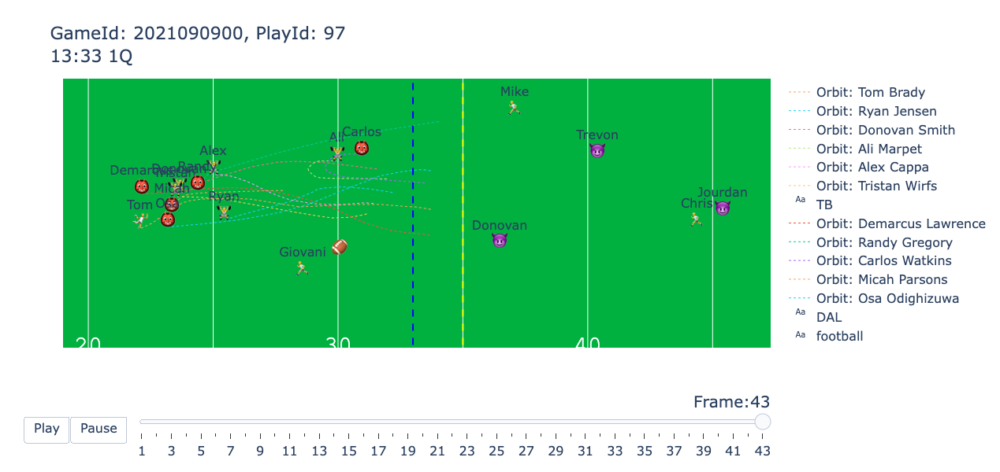

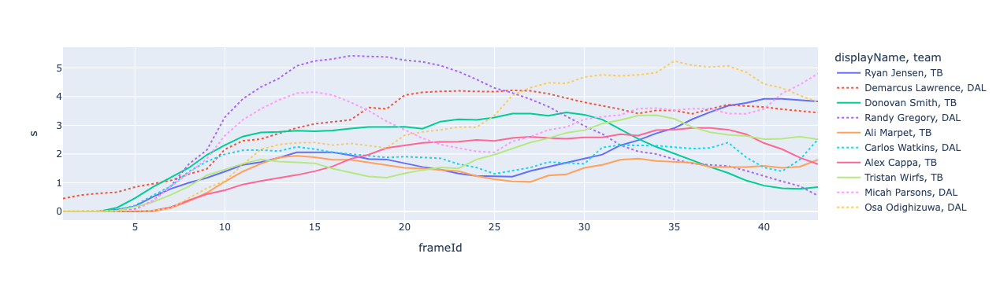

In [3]:
fig1, fig_speed_line = animate_play_v2(week1,plays,players,pffScoutingData,2021090900,97)
fig1.show()
fig_speed_line.show()

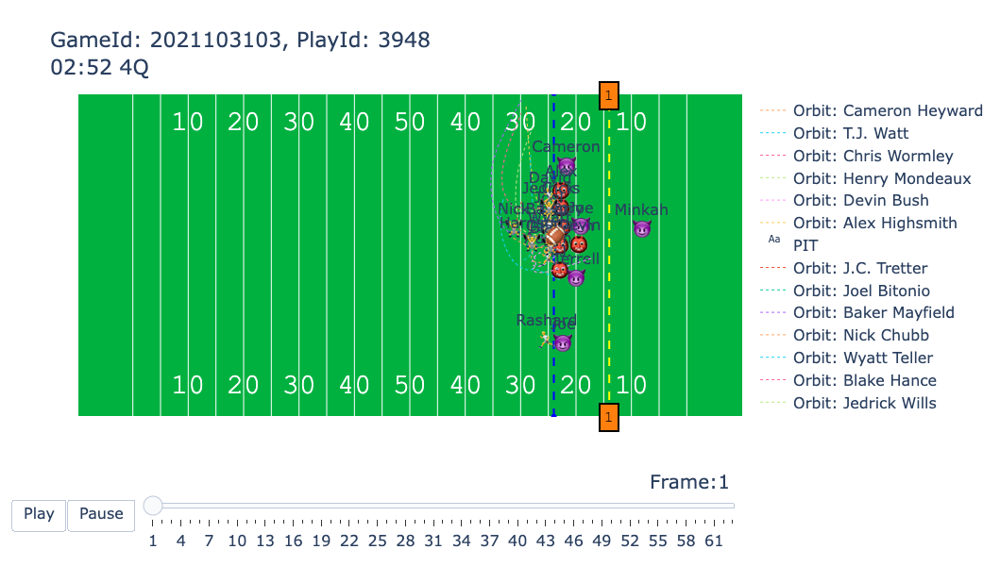

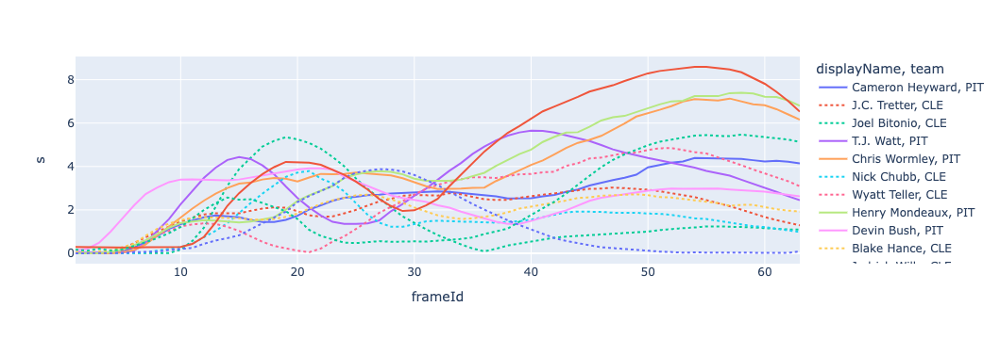

''

In [23]:
fig1, fig_speed_line = animate_play_v2(week_all,plays,players,pffScoutingData,2021103103,3948)
fig1.show()
fig_speed_line.show()
		
			
				
					
_

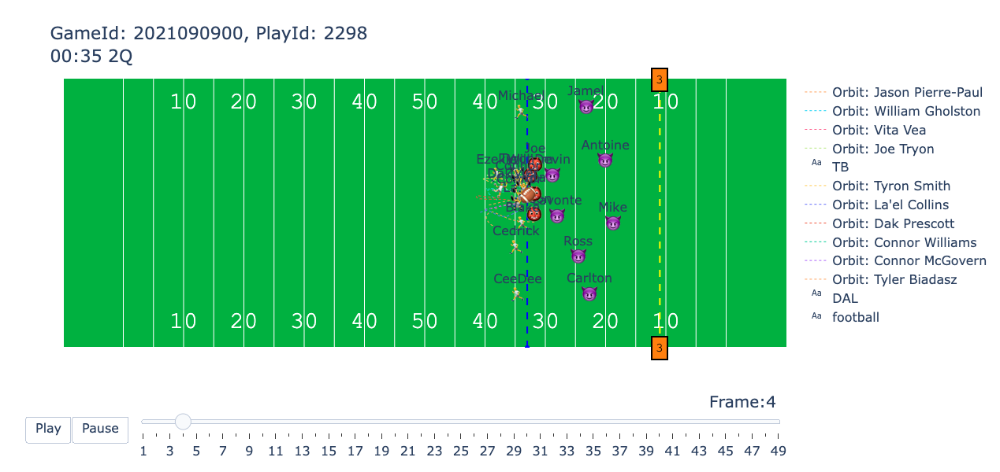

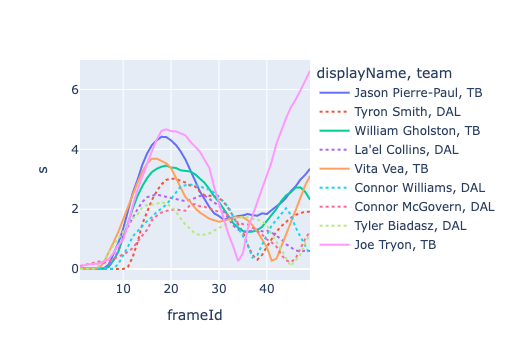

In [12]:
# Run play
fig1, fig_speed_line = animate_play_v2(week_all,plays,players,pffScoutingData,2021090900,2298)
fig1.show()
fig_speed_line.show()

# Aaron Donald
# 2021091213	3494
# 2021092611	2057
# 2021100700	2641
# 2021101706	3393
# 2021103105	1547
# 2021103105	2539

# Ndamukong Suh
# 2021090900	137	35441	0.129141	DRT	-0.260179	Ndamukong Suh


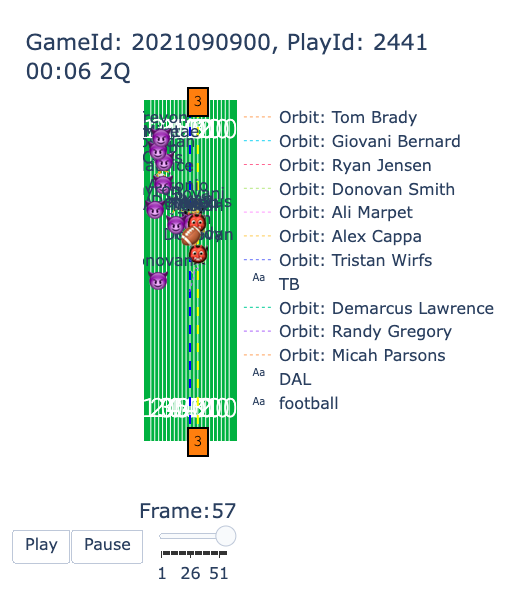

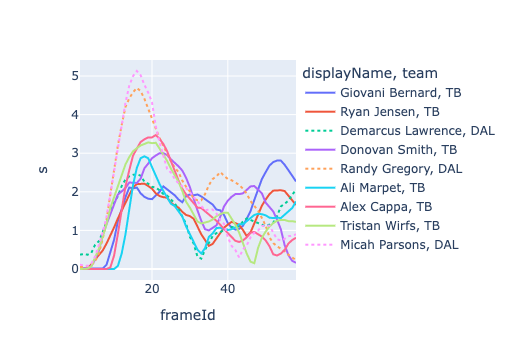

In [13]:
# Intercept play
fig1, fig_speed_line = animate_play_v2(week_all,plays,players,pffScoutingData,2021090900,2441)
fig1.show()
fig_speed_line.show()


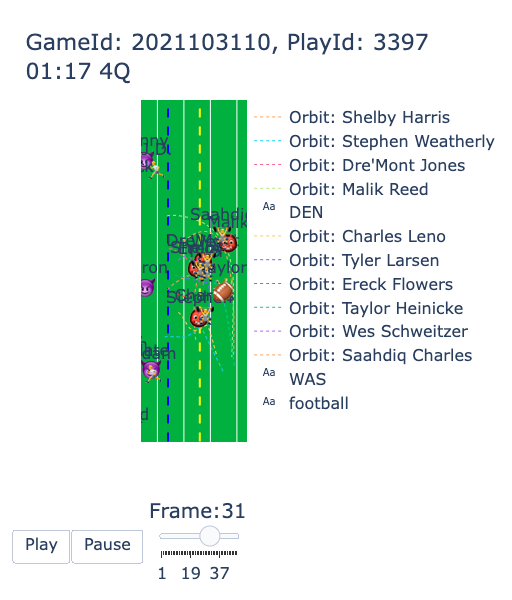

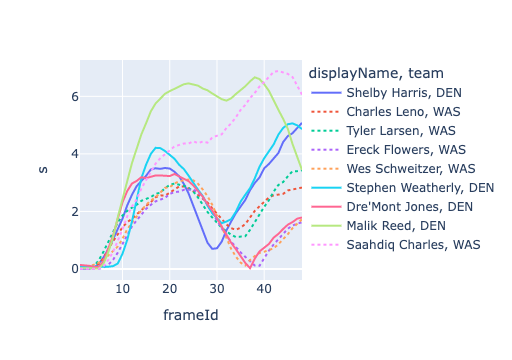

In [14]:
# Sack play
fig1, fig_speed_line = animate_play_v2(week_all,plays,players,pffScoutingData,2021103110,3397)
fig1.show()
fig_speed_line.show()


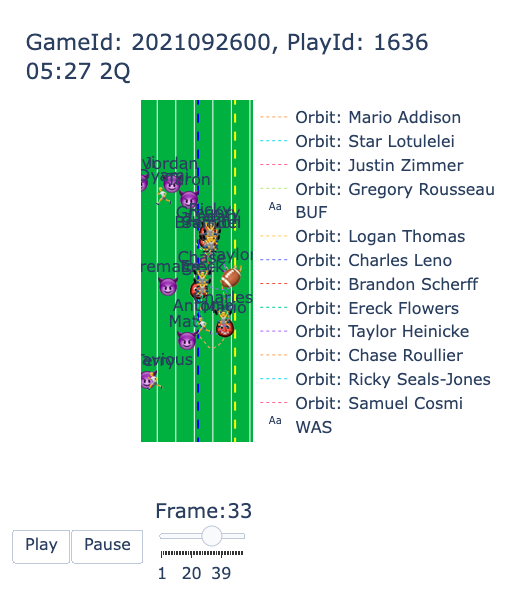

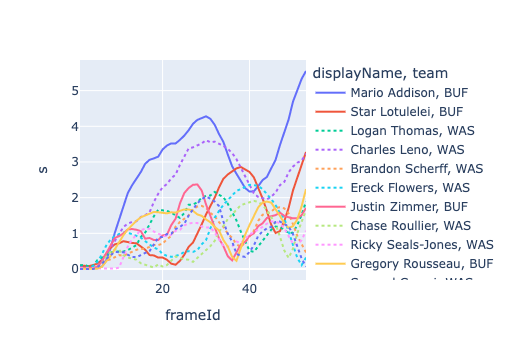

In [15]:
# R scramble play
fig1, fig_speed_line = animate_play_v2(week_all,plays,players,pffScoutingData,2021092600,1636)
fig1.show()
fig_speed_line.show()


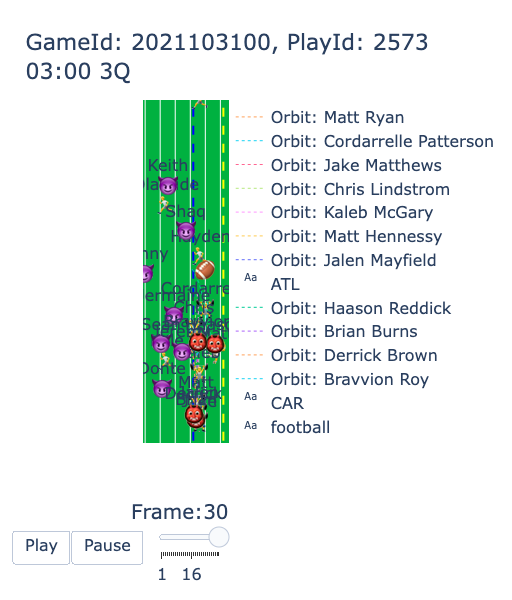

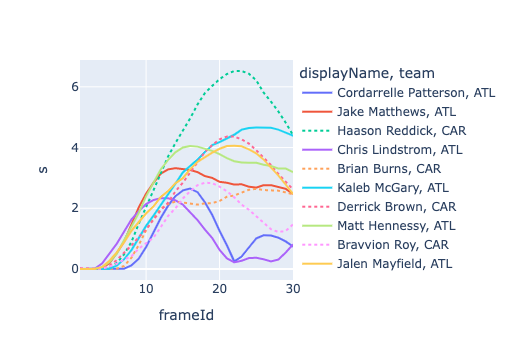

In [16]:
# パス成功しているが後ろに下がっているパターン
fig1, fig_speed_line = animate_play_v2(week_all,plays,players,pffScoutingData,2021103100,2573)
fig1.show()
fig_speed_line.show()


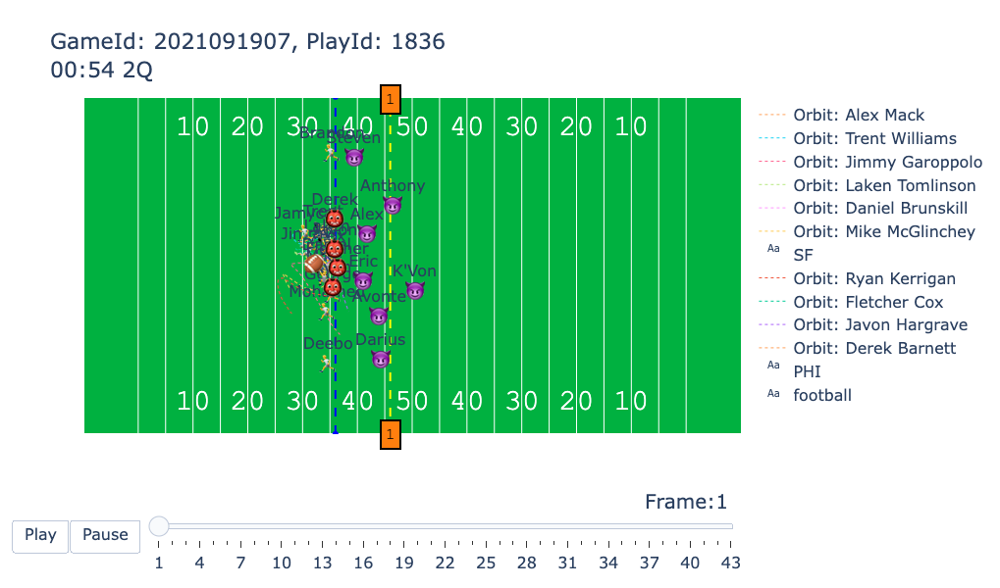

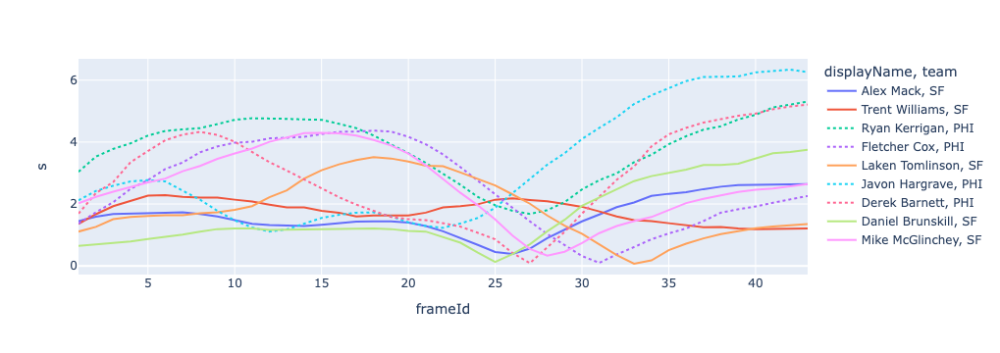

In [5]:
fig1, fig_speed_line = animate_play_v2(week_all,plays,players,pffScoutingData,2021091907,1836)
fig1.show()
fig_speed_line.show()


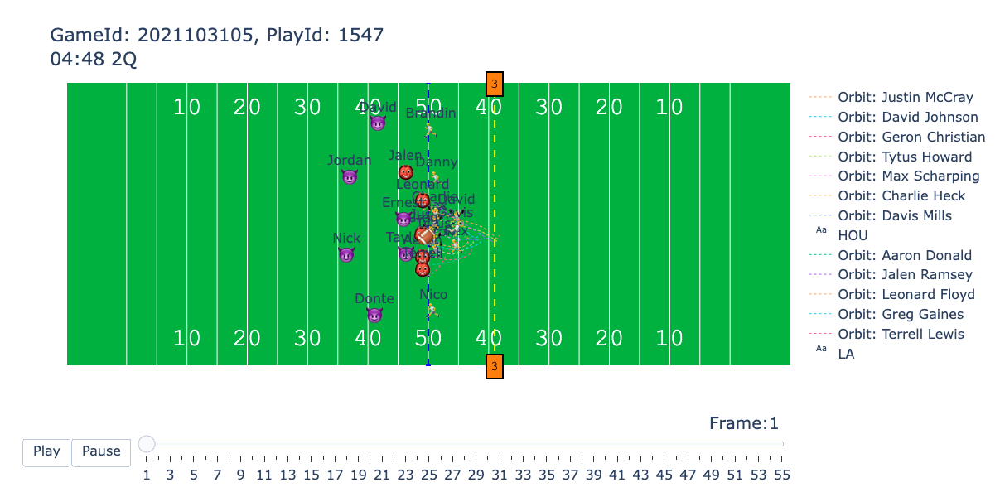

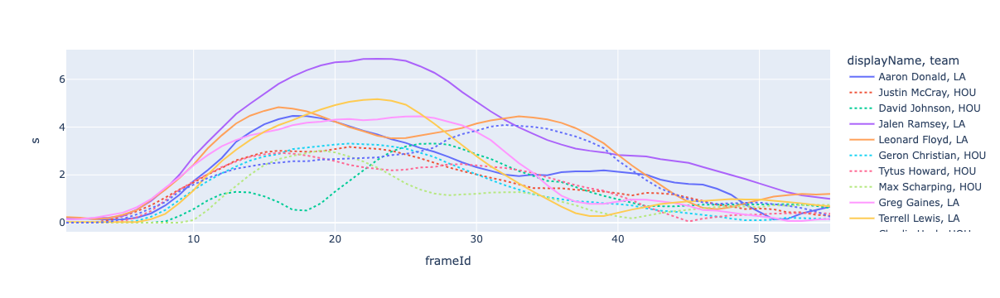

In [25]:
fig1, fig_speed_line = animate_play_v2(week_all,plays,players,pffScoutingData,2021103105,1547)
fig1.show()
fig_speed_line.show()



In [17]:
plays[(plays['gameId']==2021090900) & (plays['playId']==1776)]


,gameId,playId,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,...,foulNFLId3,absoluteYardlineNumber,offenseFormation,personnelO,defendersInBox,personnelD,dropBackType,pff_playAction,pff_passCoverage,pff_passCoverageType
32,2021090900,1776,(4:25) (Shotgun) D.Prescott to TB 10 for -5 ya...,2,2,3,DAL,TB,TB,5,...,NaN,105.0,SHOTGUN,"1 RB, 1 TE, 3 WR",7.0,"2 DL, 4 LB, 5 DB",TRADITIONAL,0,Cover-0,Man


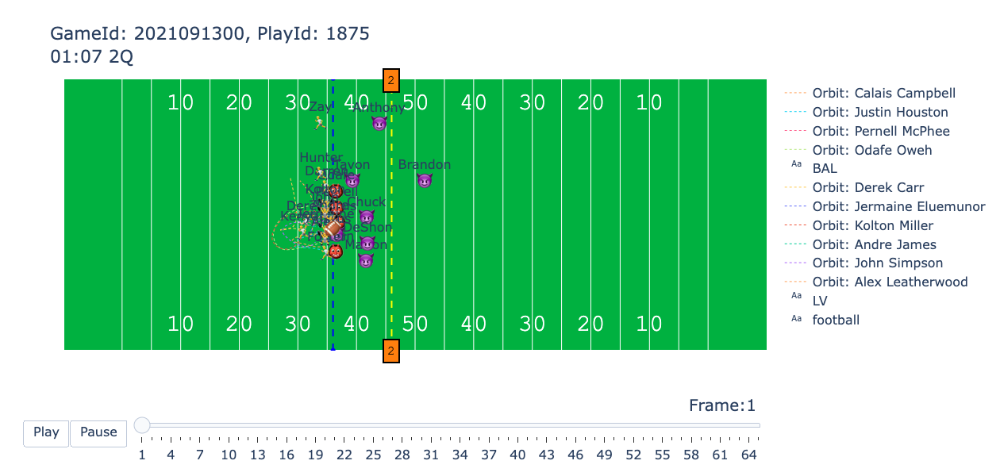

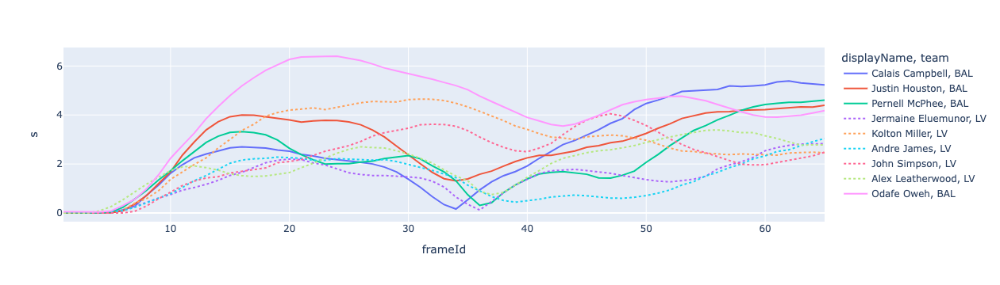

In [42]:
fig1, fig_speed_line = animate_play_v2(week1,plays,players,pffScoutingData,2021091300,1875)
fig1.show()
fig_speed_line.show()

In [32]:
plays[(plays['gameId']==2021091201) & (plays['playId']==3709)]


,gameId,playId,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,...,foulNFLId3,absoluteYardlineNumber,offenseFormation,personnelO,defendersInBox,personnelD,dropBackType,pff_playAction,pff_passCoverage,pff_passCoverageType
236,2021091201,3709,"(4:46) (No Huddle, Shotgun) B.Roethlisberger p...",4,2,7,PIT,BUF,PIT,33,...,NaN,77.0,SHOTGUN,"1 RB, 1 TE, 3 WR",7.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,1,Cover-1,Man
